In [21]:
# import subprocess
# import sys
# import os

# # Path to the venv's pip
# venv_path = r"C:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv"
# pip_path = os.path.join(venv_path, "Scripts", "pip.exe")

# # Path to requirements.txt
# req_path = os.path.join(os.getcwd(), "requirements.txt")

# # Install all packages listed in requirements.txt using the venv's pip
# subprocess.check_call([pip_path, "install", "-r", req_path])

# print("✅ All libraries installed into your .venv successfully.")

C:\Users\Toto\AppData\Local\Temp\ipykernel_34500\3910650030.py:58: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


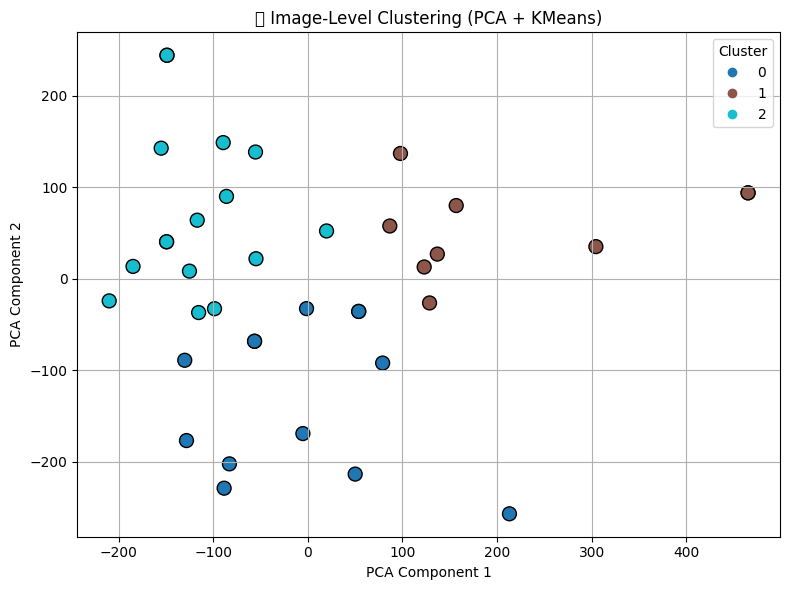


🧠 Cluster 0 - 13 images


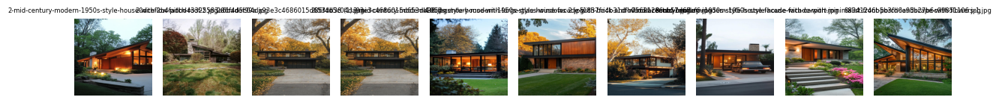


🧠 Cluster 1 - 9 images


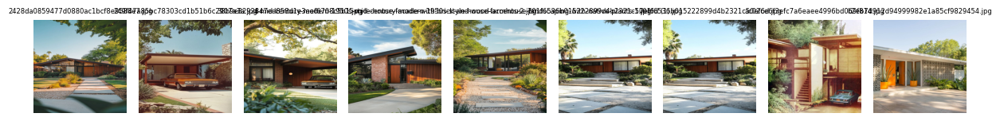


🧠 Cluster 2 - 16 images


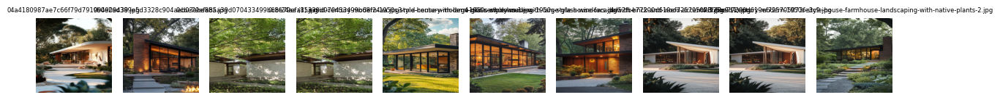

In [22]:
import os
import numpy as np
import cv2
from PIL import Image
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# -------- CONFIG --------
image_dir = r'ML-AR-MID CENTURY'
image_size = (224, 224)
n_clusters = 3  # จำนวนกลุ่มของภาพที่ต้องการ

# -------- STEP 1: Load and preprocess images (recursive) --------
image_paths = []

# อ่านภาพจากทุกโฟลเดอร์ย่อย
for root, dirs, files in os.walk(image_dir):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_paths.append(os.path.join(root, file))

images = []
names = []

for path in image_paths:
    try:
        img = Image.open(path).convert('RGB').resize(image_size)
        img_array = np.array(img).astype(np.uint8)
        images.append(img_array)
        names.append(os.path.relpath(path, image_dir))  # แสดง path ย่อยด้วย
    except Exception as e:
        print(f"❌ Error loading {path}: {e}")

# -------- STEP 2: Extract color features per image (flatten RGB) --------
features = [img.reshape(-1).astype(np.float32) for img in images]  # shape = (H*W*3,)
features = np.array(features)

# -------- STEP 3: PCA + KMeans --------
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

pca = PCA(n_components=2)
features_pca = pca.fit_transform(features_scaled)

kmeans = KMeans(n_clusters=n_clusters, random_state=42)
image_labels = kmeans.fit_predict(features_pca)

# -------- STEP 4: Scatter plot of image clusters --------
plt.figure(figsize=(8, 6))
scatter = plt.scatter(features_pca[:, 0], features_pca[:, 1], c=image_labels, cmap='tab10', s=100, edgecolors='k')
plt.title("🧠 Image-Level Clustering (PCA + KMeans)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.grid(True)
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.tight_layout()
plt.show()

# -------- STEP 5: Show sample images in each cluster --------
for cluster_id in range(n_clusters):
    indices = np.where(image_labels == cluster_id)[0]
    if len(indices) == 0:
        continue

    print(f"\n🧠 Cluster {cluster_id} - {len(indices)} images")
    plt.figure(figsize=(12, 2))
    for i, idx in enumerate(indices[:10]):  # limit to 10 images per cluster
        plt.subplot(1, min(10, len(indices)), i+1)
        plt.imshow(images[idx])
        plt.title(f"{names[idx]}", fontsize=6)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

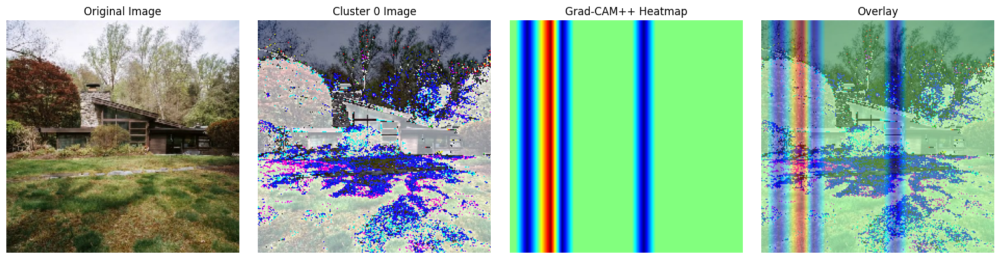

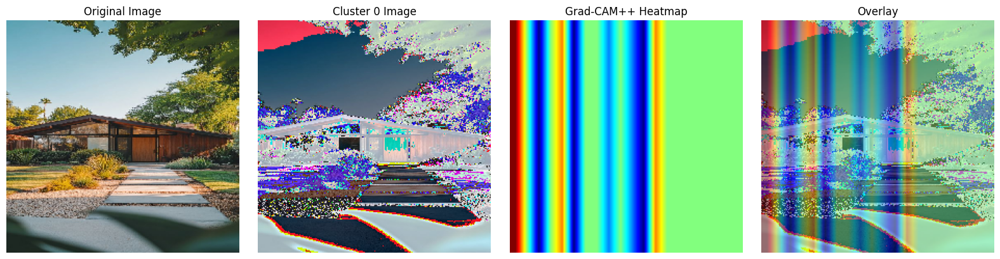

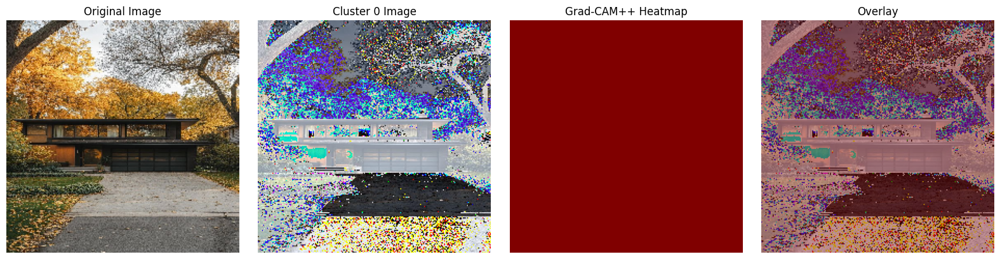

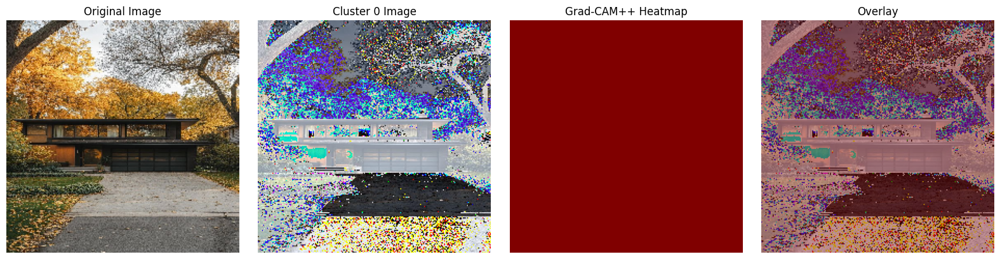

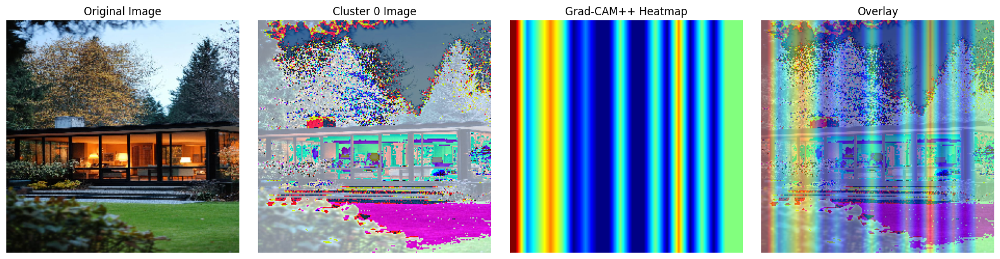

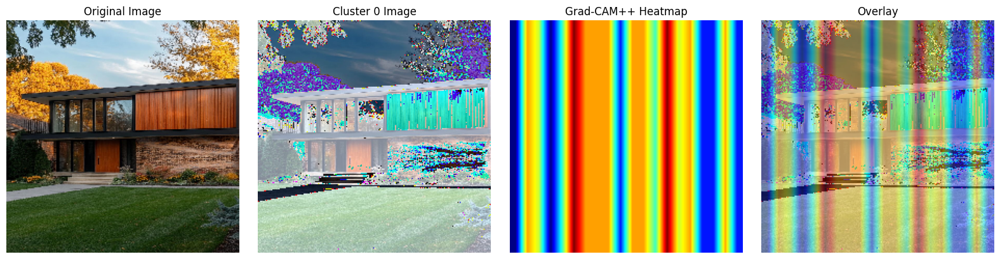

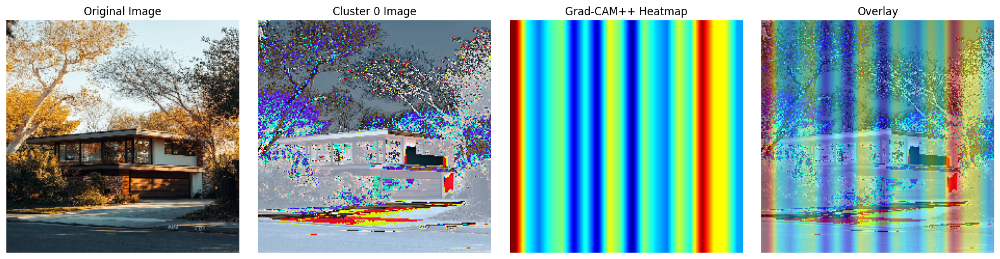


📂 Cluster 1: 29 images


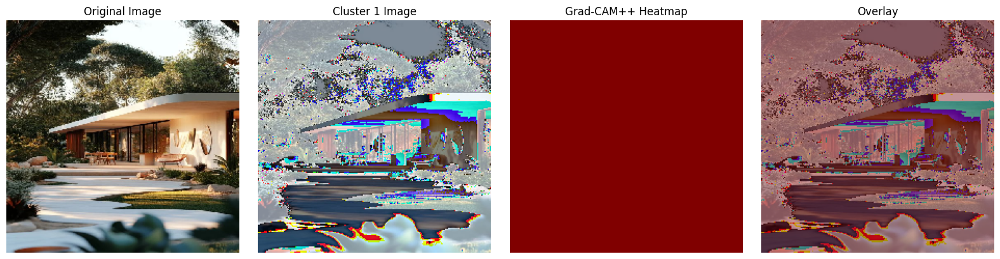

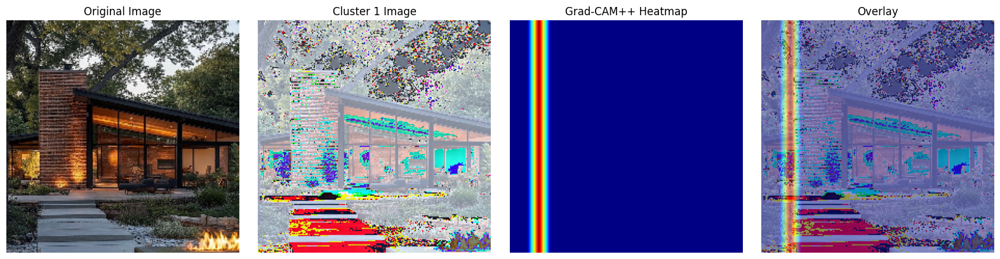

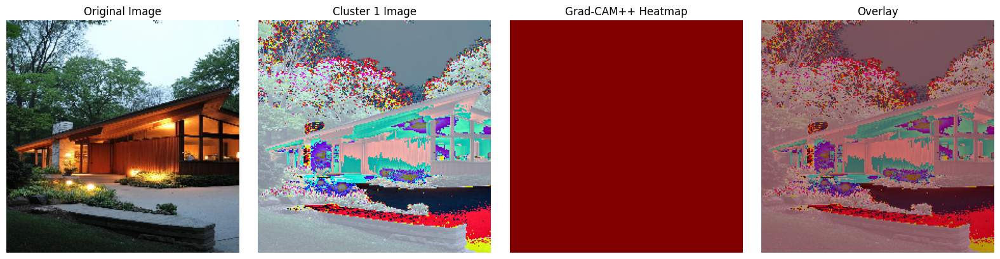

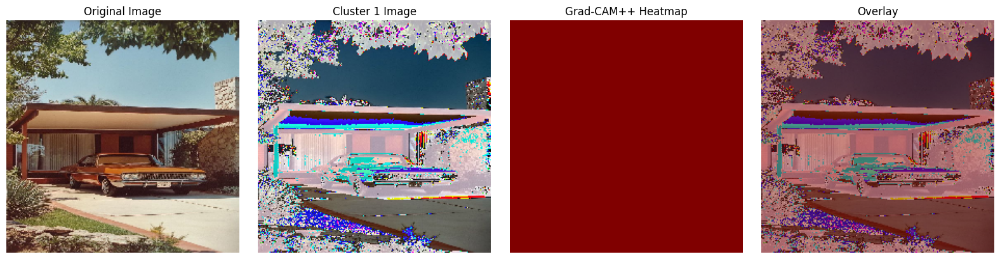

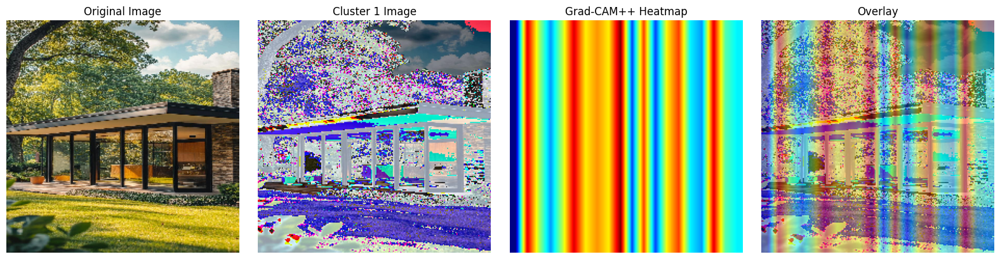

...

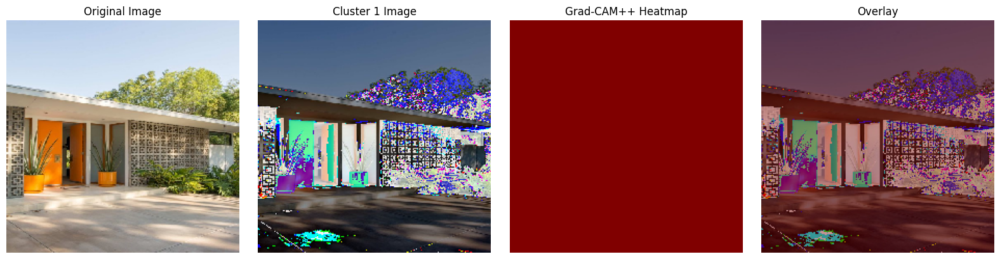

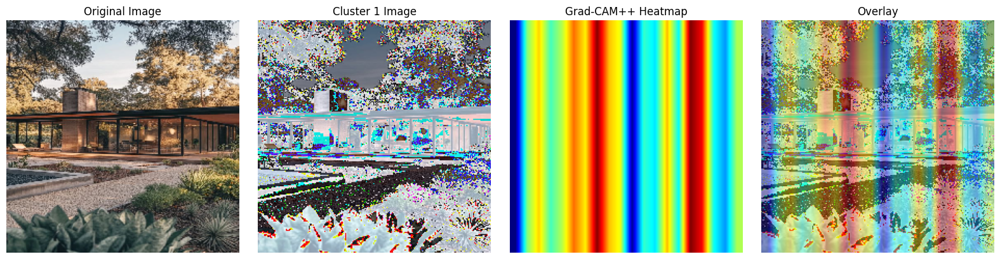

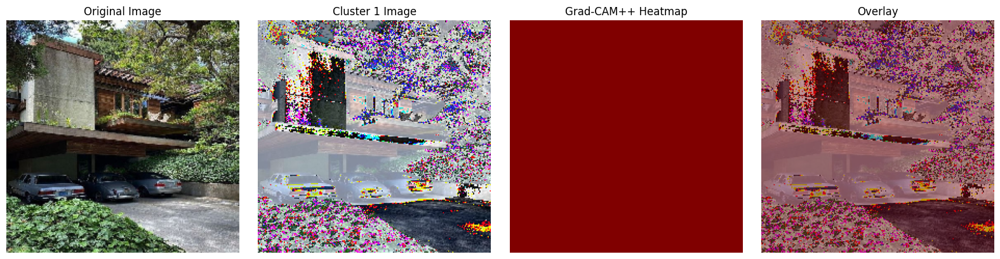

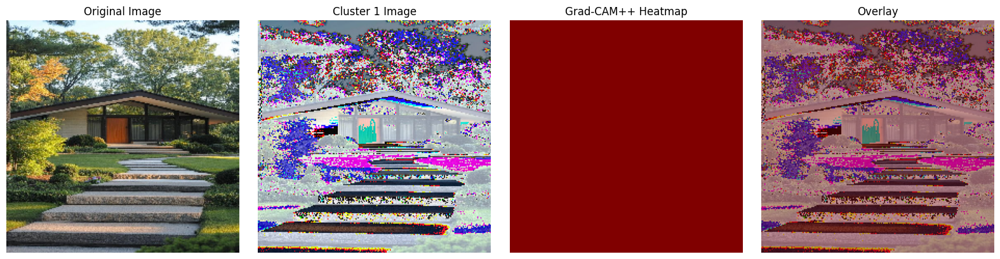

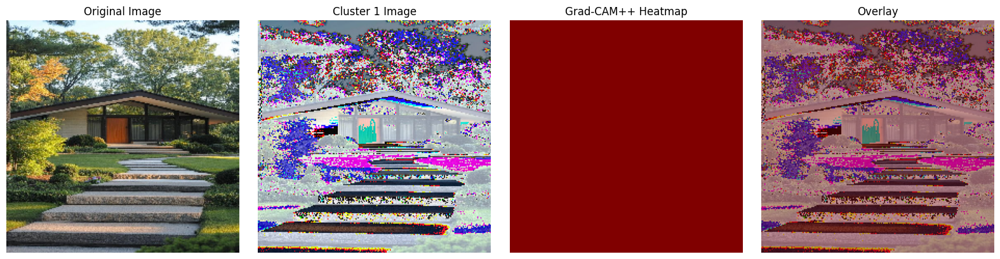


📂 Cluster 2: 2 images


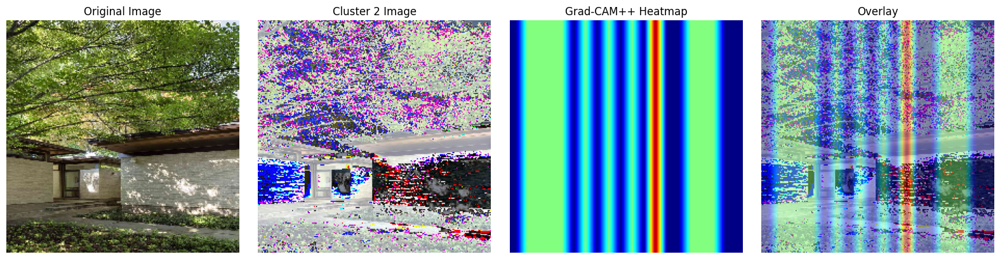

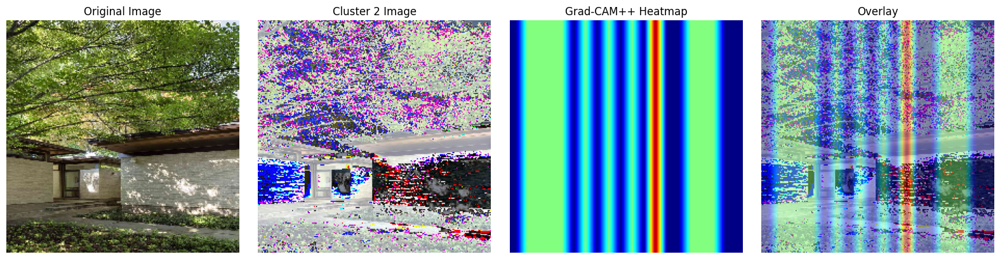

In [23]:
# Grad-CAM++ for Cluster Labels (Image-Level Clustering Analysis with Original Image Display)

import os
import numpy as np
import tensorflow as tf
from glob import glob
import matplotlib.pyplot as plt
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import cv2
from collections import Counter

# --- CONFIG ---
# image_dir = r"C:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\IRIS"

# --- Load all image paths recursively ---
image_paths = []
for root, dirs, files in os.walk(image_dir):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_paths.append(os.path.join(root, file))

image_paths = sorted(image_paths)
# n_clusters = 3

# --- STEP 1: Extract VGG16 fc1 features ---
vgg = VGG16(weights='imagenet', include_top=True)
feature_model = Model(inputs=vgg.input, outputs=vgg.get_layer('fc1').output)

features = []
for path in image_paths:
    img = load_img(path, target_size=(224, 224))
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    feat = feature_model.predict(x)
    features.append(feat.flatten())

features = np.array(features)

# --- STEP 2: Normalize + PCA + Clustering ---
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)
n_components = min(20, features_scaled.shape[0], features_scaled.shape[1])
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(features_scaled)

kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(features_pca)

# --- Filter out clusters with only 1 image ---
label_counts = Counter(cluster_labels)
valid_indices = [i for i in range(len(cluster_labels)) if label_counts[cluster_labels[i]] > 1]
features_pca = features_pca[valid_indices]
cluster_labels = np.array(cluster_labels)[valid_indices]
image_paths = [image_paths[i] for i in valid_indices]
features = features[valid_indices]

# --- STEP 3: Build Classifier (Functional API) ---
inputs = Input(shape=(n_components,))
x = Dense(64, activation='relu')(inputs)
x = Dense(32, activation='relu')(x)
outputs = Dense(n_clusters, activation='softmax')(x)
classifier = Model(inputs=inputs, outputs=outputs)
classifier.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

X_train, X_test, y_train, y_test, path_train, path_test = train_test_split(
    features_pca, cluster_labels, image_paths, test_size=0.2, random_state=42, stratify=cluster_labels
)
classifier.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=30, batch_size=8)

# --- STEP 4: Grad-CAM++ for cluster label ---
def compute_gradcam_plus_plus_cluster(input_feature, model, label_index):
    input_tensor = tf.convert_to_tensor(np.expand_dims(input_feature, axis=0), dtype=tf.float32)

    with tf.GradientTape(persistent=True) as tape1:
        with tf.GradientTape(persistent=True) as tape2:
            with tf.GradientTape() as tape3:
                tape1.watch(input_tensor)
                tape2.watch(input_tensor)
                tape3.watch(input_tensor)
                pred = model(input_tensor)
                loss = pred[:, label_index]

            grads = tape3.gradient(loss, input_tensor)
        grads2 = tape2.gradient(grads, input_tensor)
    grads3 = tape1.gradient(grads2, input_tensor)

    grads = grads[0]
    grads2 = grads2[0]
    grads3 = grads3[0]

    numerator = grads**2
    denominator = 2 * grads**2 + grads2 * input_feature + 1e-8
    alpha = numerator / (denominator + 1e-8)
    weights = tf.reduce_sum(alpha * tf.maximum(grads, 0.0), axis=0)
    return weights.numpy()

# --- STEP 5: Visualize all images grouped by cluster with original image ---
for cluster_id in range(n_clusters):
    indices = np.where(cluster_labels == cluster_id)[0]
    if len(indices) < 1:
        continue
    print(f"\n📂 Cluster {cluster_id}: {len(indices)} images")
    for idx in indices:
        img_path = image_paths[idx]
        img = load_img(img_path, target_size=(224, 224))
        original_img = np.array(img)
        x = img_to_array(img)
        x_processed = preprocess_input(np.expand_dims(x, axis=0))
        img_vis = x.astype(np.uint8)

        cluster_feature = features_pca[idx]
        cam_weights = compute_gradcam_plus_plus_cluster(cluster_feature, classifier, cluster_id)

        # Map weights back to image space using PCA components
        weighted_map = np.dot(cam_weights, pca.components_)
        weighted_map = scaler.inverse_transform(weighted_map)
        heatmap = np.dot(weighted_map, features[idx].reshape(-1, 1)).reshape(1, -1)
        heatmap = np.abs(heatmap.reshape((1, -1)))

        # Normalize and convert to heatmap image
        heatmap = heatmap - np.min(heatmap)
        heatmap = heatmap / np.max(heatmap + 1e-8)
        heatmap_img = cv2.resize(heatmap.reshape(1, -1), (224, 224))
        heatmap_img = np.uint8(255 * heatmap_img)
        heatmap_color = cv2.applyColorMap(heatmap_img, cv2.COLORMAP_JET)
        overlay = cv2.addWeighted(img_vis, 0.6, heatmap_color, 0.4, 0)

        # Visualization
        plt.figure(figsize=(16, 4))
        plt.subplot(1, 4, 1)
        plt.imshow(original_img)
        plt.title("Original Image")
        plt.axis('off')

        plt.subplot(1, 4, 2)
        plt.imshow(img_vis)
        plt.title(f"Cluster {cluster_id} Image")
        plt.axis('off')

        plt.subplot(1, 4, 3)
        plt.imshow(heatmap_color)
        plt.title("Grad-CAM++ Heatmap")
        plt.axis('off')

        plt.subplot(1, 4, 4)
        plt.imshow(overlay)
        plt.title("Overlay")
        plt.axis('off')

        plt.tight_layout()
        plt.show()



🧠 Showing average heatmap per cluster...


C:\Users\Toto\AppData\Local\Temp\ipykernel_34500\752861400.py:43: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


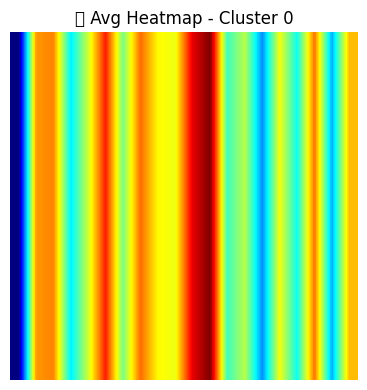

C:\Users\Toto\AppData\Local\Temp\ipykernel_34500\752861400.py:43: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


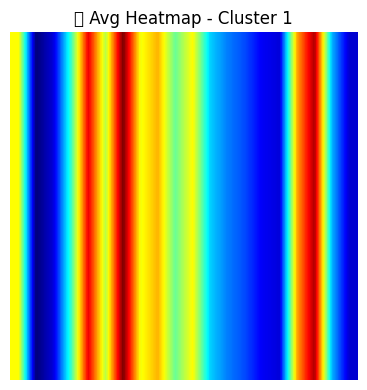

C:\Users\Toto\AppData\Local\Temp\ipykernel_34500\752861400.py:43: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


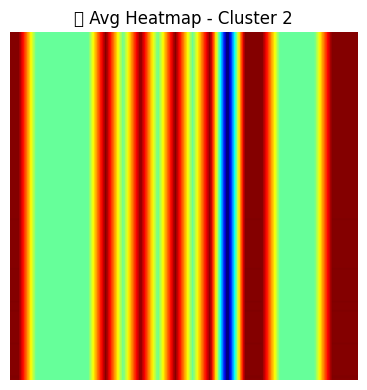

In [24]:
# --- STEP 6: Aggregate heatmaps by cluster ---
print("\n🧠 Showing average heatmap per cluster...")

for cluster_id in range(n_clusters):
    indices = np.where(cluster_labels == cluster_id)[0]
    if len(indices) < 1:
        continue

    summed_heatmap = np.zeros((224, 224), dtype=np.float32)

    for idx in indices:
        img_path = image_paths[idx]
        img = load_img(img_path, target_size=(224, 224))
        x = img_to_array(img)
        x_processed = preprocess_input(np.expand_dims(x, axis=0))

        cluster_feature = features_pca[idx]
        cam_weights = compute_gradcam_plus_plus_cluster(cluster_feature, classifier, cluster_id)

        # Project weights → heatmap
        weighted_map = np.dot(cam_weights, pca.components_)
        weighted_map = scaler.inverse_transform(weighted_map)
        heatmap = np.dot(weighted_map, features[idx].reshape(-1, 1)).reshape(1, -1)
        heatmap = np.abs(heatmap.reshape((1, -1)))
        heatmap = heatmap - np.min(heatmap)
        heatmap = heatmap / (np.max(heatmap) + 1e-8)
        heatmap_resized = cv2.resize(heatmap.reshape(1, -1), (224, 224))

        summed_heatmap += heatmap_resized

    # เฉลี่ย
    avg_heatmap = summed_heatmap / len(indices)
    avg_heatmap = avg_heatmap - np.min(avg_heatmap)
    avg_heatmap = avg_heatmap / (np.max(avg_heatmap) + 1e-8)
    avg_heatmap_uint8 = np.uint8(255 * avg_heatmap)
    avg_heatmap_color = cv2.applyColorMap(avg_heatmap_uint8, cv2.COLORMAP_JET)

    # แสดง
    plt.figure(figsize=(6, 4))
    plt.imshow(avg_heatmap_color[..., ::-1])
    plt.title(f"🔥 Avg Heatmap - Cluster {cluster_id}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

C:\Users\Toto\AppData\Local\Temp\ipykernel_34500\2335550670.py:139: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
c:\Users\Toto\Documents\_PLP\RD-Trend\RD-Trend\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128293 (\N{FIRE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


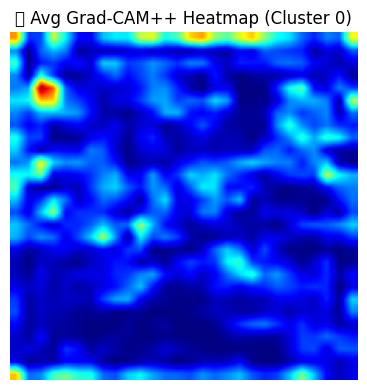

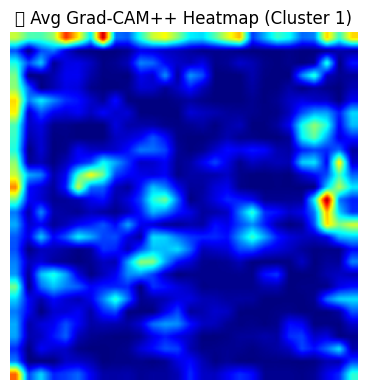

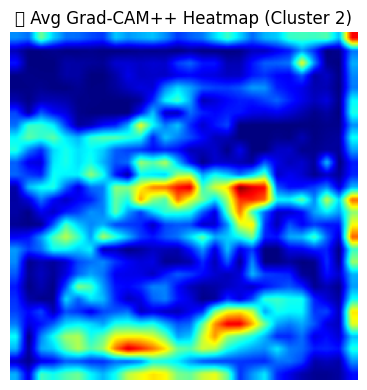

In [30]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
from collections import Counter
from glob import glob
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# -------- CONFIG --------
image_dir = r"ML-AR-MID CENTURY"
image_paths = []
for root, dirs, files in os.walk(image_dir):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_paths.append(os.path.join(root, file))
image_paths = sorted(image_paths)
# n_clusters = 3

# -------- Load VGG16 conv layer --------
base_model = VGG16(weights='imagenet')
conv_layer_name = 'block4_conv3'
conv_model = Model(inputs=base_model.input, outputs=base_model.get_layer(conv_layer_name).output)

features = []
conv_outputs = []
for path in image_paths:
    img = load_img(path, target_size=(224, 224))
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    conv_out = conv_model.predict(x)
    pooled = np.mean(conv_out, axis=(1, 2))  # GAP
    features.append(pooled[0])
    conv_outputs.append(conv_out[0])  # save conv map (H,W,C)

features = np.array(features)

# -------- PCA + KMeans --------
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)
n_components = min(20, features_scaled.shape[0], features_scaled.shape[1])
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(features_scaled)

kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(features_pca)

# -------- Filter out small clusters --------
label_counts = Counter(cluster_labels)
valid_indices = [i for i in range(len(cluster_labels)) if label_counts[cluster_labels[i]] > 1]
features_pca = features_pca[valid_indices]
cluster_labels = np.array(cluster_labels)[valid_indices]
image_paths = [image_paths[i] for i in valid_indices]
conv_outputs = [conv_outputs[i] for i in valid_indices]
features = features[valid_indices]

# -------- Train classifier --------
inputs = Input(shape=(n_components,))
x = Dense(64, activation='relu')(inputs)
x = Dense(32, activation='relu')(x)
outputs = Dense(n_clusters, activation='softmax')(x)
classifier = Model(inputs=inputs, outputs=outputs)
classifier.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

X_train, X_test, y_train, y_test, _, _ = train_test_split(
    features_pca, cluster_labels, image_paths, test_size=0.2, random_state=42, stratify=cluster_labels
)
classifier.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=30, batch_size=8)

# -------- Grad-CAM++ function --------
def compute_gradcam_plus_plus_conv(conv_output, model, input_feature, class_index):
    input_tensor = tf.convert_to_tensor(np.expand_dims(input_feature, axis=0), dtype=tf.float32)

    with tf.GradientTape(persistent=True) as tape1:
        with tf.GradientTape(persistent=True) as tape2:
            with tf.GradientTape() as tape3:
                tape1.watch(input_tensor)
                tape2.watch(input_tensor)
                tape3.watch(input_tensor)
                pred = model(input_tensor)
                loss = pred[:, class_index]
            grads = tape3.gradient(loss, input_tensor)
        grads2 = tape2.gradient(grads, input_tensor)
    grads3 = tape1.gradient(grads2, input_tensor)

    grads = grads[0].numpy()
    grads2 = grads2[0].numpy()
    grads3 = grads3[0].numpy()

    numerator = grads**2
    denominator = 2 * grads**2 + grads2 * input_feature + 1e-8
    alpha = numerator / (denominator + 1e-8)
    weights = alpha * np.maximum(grads, 0.0)

    cam = np.zeros(shape=conv_output.shape[:2], dtype=np.float32)
    for i, w in enumerate(weights):
        if i < conv_output.shape[-1]:
            cam += w * conv_output[:, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / (np.max(cam) + 1e-8)
    return cam  # shape (28,28)

# -------- STEP: Average heatmap per cluster --------
print("\n🔥 Showing average Grad-CAM++ heatmap per cluster...")

for cluster_id in range(n_clusters):
    indices = np.where(cluster_labels == cluster_id)[0]
    if len(indices) < 1:
        continue

    summed_heatmap = np.zeros((28, 28), dtype=np.float32)

    for idx in indices:
        input_feat = features_pca[idx]
        conv_feat = conv_outputs[idx]
        cam = compute_gradcam_plus_plus_conv(conv_feat, classifier, input_feat, cluster_id)
        summed_heatmap += cam  # size 28x28

    avg_cam = summed_heatmap / len(indices)
    avg_cam = avg_cam - np.min(avg_cam)
    avg_cam = avg_cam / (np.max(avg_cam) + 1e-8)
    avg_cam_resized = cv2.resize(avg_cam, (224, 224))
    cam_uint8 = np.uint8(255 * avg_cam_resized)
    cam_color = cv2.applyColorMap(cam_uint8, cv2.COLORMAP_JET)

    plt.figure(figsize=(6, 4))
    plt.imshow(cam_color[..., ::-1])
    plt.title(f"🔥 Avg Grad-CAM++ Heatmap (Cluster {cluster_id})")
    plt.axis('off')
    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

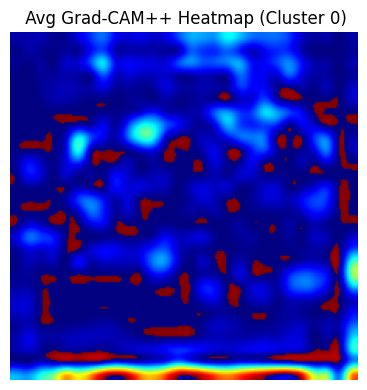

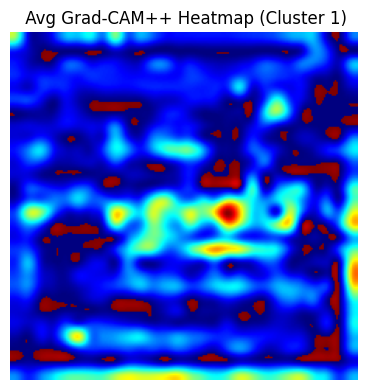

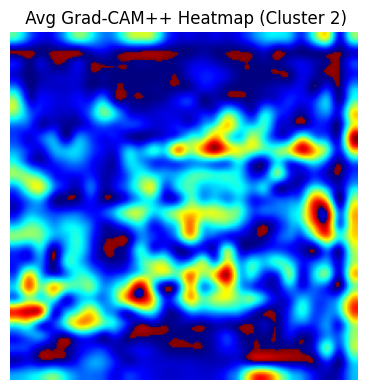

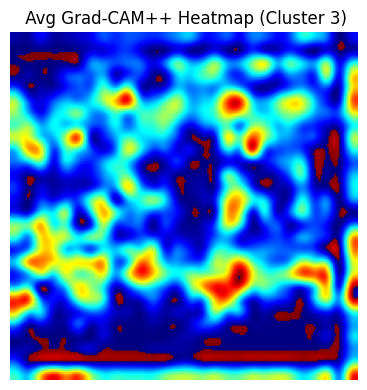

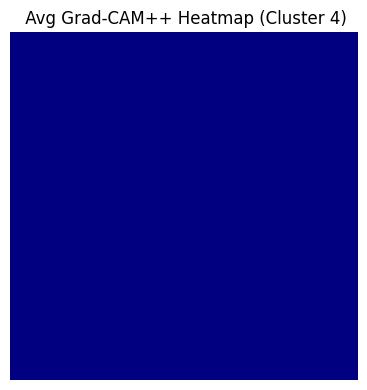

In [43]:
# Grad-CAM++ Using Conv Layer (Spatial Heatmap Shape for Cluster Summary, with Sharper Output)

import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
from collections import Counter
from glob import glob
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# -------- CONFIG --------
image_dir = r"dataset"
image_paths = []
for root, dirs, files in os.walk(image_dir):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            image_paths.append(os.path.join(root, file))
image_paths = sorted(image_paths)
n_clusters = 5

# -------- Load VGG16 conv layer --------
base_model = VGG16(weights='imagenet')
conv_layer_name = 'block4_conv3'
conv_model = Model(inputs=base_model.input, outputs=base_model.get_layer(conv_layer_name).output)

features = []
conv_outputs = []
for path in image_paths:
    img = load_img(path, target_size=(224, 224))
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    conv_out = conv_model.predict(x)
    pooled = np.mean(conv_out, axis=(1, 2))  # GAP
    features.append(pooled[0])
    conv_outputs.append(conv_out[0])  # save conv map (H,W,C)

features = np.array(features)

# -------- PCA + KMeans --------
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)
n_components = min(5, features_scaled.shape[0], features_scaled.shape[1])
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(features_scaled)

kmeans = KMeans(n_clusters=n_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(features_pca)

# -------- Filter out small clusters --------
label_counts = Counter(cluster_labels)
valid_indices = [i for i in range(len(cluster_labels)) if label_counts[cluster_labels[i]] > 1]
features_pca = features_pca[valid_indices]
cluster_labels = np.array(cluster_labels)[valid_indices]
image_paths = [image_paths[i] for i in valid_indices]
conv_outputs = [conv_outputs[i] for i in valid_indices]
features = features[valid_indices]

# -------- Train classifier --------
inputs = Input(shape=(n_components,))
x = Dense(64, activation='relu')(inputs)
x = Dense(32, activation='relu')(x)
outputs = Dense(n_clusters, activation='softmax')(x)
classifier = Model(inputs=inputs, outputs=outputs)
classifier.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

X_train, X_test, y_train, y_test, _, _ = train_test_split(
    features_pca, cluster_labels, image_paths, test_size=0.2, random_state=42, stratify=cluster_labels
)
classifier.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=30, batch_size=8)

# -------- Grad-CAM++ function --------
def compute_gradcam_plus_plus_conv(conv_output, model, input_feature, class_index):
    input_tensor = tf.convert_to_tensor(np.expand_dims(input_feature, axis=0), dtype=tf.float32)

    with tf.GradientTape(persistent=True) as tape1:
        with tf.GradientTape(persistent=True) as tape2:
            with tf.GradientTape() as tape3:
                tape1.watch(input_tensor)
                tape2.watch(input_tensor)
                tape3.watch(input_tensor)
                pred = model(input_tensor)
                loss = pred[:, class_index]
            grads = tape3.gradient(loss, input_tensor)
        grads2 = tape2.gradient(grads, input_tensor)
    grads3 = tape1.gradient(grads2, input_tensor)

    grads = grads[0].numpy()
    grads2 = grads2[0].numpy()
    grads3 = grads3[0].numpy()

    numerator = grads**2
    denominator = 2 * grads**2 + grads2 * input_feature + 1e-8
    alpha = numerator / (denominator + 1e-8)
    weights = alpha * np.maximum(grads, 0.0)

    cam = np.zeros(shape=conv_output.shape[:2], dtype=np.float32)
    for i, w in enumerate(weights):
        if i < conv_output.shape[-1]:
            cam += w * conv_output[:, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / (np.max(cam) + 1e-8)
    return cam  # shape (28,28)

# -------- STEP: Average heatmap per cluster --------
print("\n🔥 Showing average Grad-CAM++ heatmap per cluster...")

for cluster_id in range(n_clusters):
    indices = np.where(cluster_labels == cluster_id)[0]
    if len(indices) < 1:
        continue

    summed_heatmap = np.zeros((28, 28), dtype=np.float32)

    for idx in indices:
        input_feat = features_pca[idx]
        conv_feat = conv_outputs[idx]
        cam = compute_gradcam_plus_plus_conv(conv_feat, classifier, input_feat, cluster_id)
        summed_heatmap += cam  # size 28x28

    avg_cam = summed_heatmap / len(indices)
    avg_cam = avg_cam - np.min(avg_cam)
    avg_cam = avg_cam / (np.max(avg_cam) + 1e-8)
    avg_cam_resized = cv2.resize(avg_cam, (224, 224), interpolation=cv2.INTER_CUBIC)
    avg_cam_resized = cv2.GaussianBlur(avg_cam_resized, (3, 3), 0)

    cam_uint8 = np.uint8(255 * avg_cam_resized)
    cam_color = cv2.applyColorMap(cam_uint8, cv2.COLORMAP_JET)

    plt.figure(figsize=(6, 4))
    plt.imshow(cam_color[..., ::-1])
    plt.title(f" Avg Grad-CAM++ Heatmap (Cluster {cluster_id})")
    plt.axis('off')
    plt.tight_layout()
    plt.show()
